## convert the ogg file to wav
## change the SR

In [2]:
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter(action='ignore', category=FutureWarning)

import librosa
import librosa.display
import soundfile as sf
import matplotlib.pyplot as plt
import os
import numpy as np
from tqdm import tqdm
import cv2
from joblib import delayed,Parallel
import pandas as pd

import os, json, random
import numpy as np, pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf, re, math
from tqdm import tqdm


In [2]:
train_df = pd.read_csv('../data/birdclef-2022/train_metadata.csv')

In [3]:
train_df.head()

,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,time,url,filename
0,afrsil1,[],"['call', 'flight call']",12.3910,-1.4930,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,2.5,08:00,https://www.xeno-canto.org/125458,afrsil1/XC125458.ogg
1,afrsil1,"['houspa', 'redava', 'zebdov']",['call'],19.8801,-155.7254,Euodice cantans,African Silverbill,Dan Lane,Creative Commons Attribution-NonCommercial-Sha...,3.5,08:30,https://www.xeno-canto.org/175522,afrsil1/XC175522.ogg
2,afrsil1,[],"['call', 'song']",16.2901,-16.0321,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,4.0,11:30,https://www.xeno-canto.org/177993,afrsil1/XC177993.ogg
3,afrsil1,[],"['alarm call', 'call']",17.0922,54.2958,Euodice cantans,African Silverbill,Oscar Campbell,Creative Commons Attribution-NonCommercial-Sha...,4.0,11:00,https://www.xeno-canto.org/205893,afrsil1/XC205893.ogg
4,afrsil1,[],['flight call'],21.4581,-157.7252,Euodice cantans,African Silverbill,Ross Gallardy,Creative Commons Attribution-NonCommercial-Sha...,3.0,16:30,https://www.xeno-canto.org/207431,afrsil1/XC207431.ogg


In [4]:
folder_wav = '../data/birdclef-2022/train_audio_wav/'
for i in train_df['primary_label'].value_counts().index.values:
    os.mkdir(folder_wav+i)

FileExistsError: [Errno 17] File exists: '../data/birdclef-2022/train_audio_wav/brnowl'

In [5]:
Target_sr = 44100
folder = '../data/birdclef-2022/train_audio/'
folder_wav = '../data/birdclef-2022/train_audio_wav/'
def resample_to_wav(x):
    y, original_sr = librosa.load(folder+x, sr = None)
    resample_y = librosa.resample(y, orig_sr=original_sr, target_sr=Target_sr)
    f_name = x.split('.')[0]
    #librosa.output.write_wav(f'../data/train_soundscapes/{f_name}.wav', resample_y, Target_sr,) 
    sf.write(folder_wav + f'{f_name}.wav', resample_y, Target_sr)



_ = Parallel(n_jobs=8, verbose=1)(
    delayed(resample_to_wav)(
    file,
    ) for file in train_df['filename'].values#[:3]#[:5]
)

[Parallel(n_jobs=8)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    7.2s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:   30.4s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:   59.6s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:  1.7min
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:  2.4min
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:  4.1min
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:  5.6min
[Parallel(n_jobs=8)]: Done 3184 tasks      | elapsed:  7.6min
[Parallel(n_jobs=8)]: Done 4034 tasks      | elapsed: 10.6min
[Parallel(n_jobs=8)]: Done 4984 tasks      | elapsed: 12.6min
[Parallel(n_jobs=8)]: Done 6034 tasks      | elapsed: 14.7min
[Parallel(n_jobs=8)]: Done 7184 tasks      | elapsed: 18.4min
[Parallel(n_jobs=8)]: Done 8434 tasks      | elapsed: 21.2min
[Parallel(n_jobs=8)]: Done 9784 tasks      | elapsed: 26.3min
[Parallel(n_jobs=8)]: Done 11234 tasks      | elapsed: 30.6mi

## lets make the librosa mel spec for 10 sec

In [2]:
train_df = pd.read_csv('../data/birdclef-2022/train_metadata.csv')

In [3]:
train_df.head()

,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,time,url,filename
0,afrsil1,[],"['call', 'flight call']",12.3910,-1.4930,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,2.5,08:00,https://www.xeno-canto.org/125458,afrsil1/XC125458.ogg
1,afrsil1,"['houspa', 'redava', 'zebdov']",['call'],19.8801,-155.7254,Euodice cantans,African Silverbill,Dan Lane,Creative Commons Attribution-NonCommercial-Sha...,3.5,08:30,https://www.xeno-canto.org/175522,afrsil1/XC175522.ogg
2,afrsil1,[],"['call', 'song']",16.2901,-16.0321,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,4.0,11:30,https://www.xeno-canto.org/177993,afrsil1/XC177993.ogg
3,afrsil1,[],"['alarm call', 'call']",17.0922,54.2958,Euodice cantans,African Silverbill,Oscar Campbell,Creative Commons Attribution-NonCommercial-Sha...,4.0,11:00,https://www.xeno-canto.org/205893,afrsil1/XC205893.ogg
4,afrsil1,[],['flight call'],21.4581,-157.7252,Euodice cantans,African Silverbill,Ross Gallardy,Creative Commons Attribution-NonCommercial-Sha...,3.0,16:30,https://www.xeno-canto.org/207431,afrsil1/XC207431.ogg


In [3]:
folder_wav = '../data/librosa/competition/v1/10_sec/'
for i in train_df['primary_label'].value_counts().index.values:
    os.mkdir(folder_wav+i)

In [4]:
SR = 44100
SEC = 10
atleast_sec = 3
n_fft = 1024
hop_length = 512
n_mels = 128
NewMax = 255.
NewMin = 0.
folder_wav = f'../data/librosa/competition/v1/{SEC}_sec/'

def image_creation(file,):
    file = file.replace('ogg','wav')
    y, sr = librosa.load(f'../data/birdclef-2022/train_audio_wav/{file}', sr = None)
    
    for i in range(0, int(len(y)/44100), SEC):
        
        ## lets check if the sound track is atleast greater than 3 sec
        wave = y[i*SR:(i+SEC)*SR]
        
        if len(wave)> atleast_sec * SR:
            
            if len(wave)< SEC * SR:
                wave = np.concatenate([wave, np.array([0.]*abs(wave.shape[0] - SEC*SR))])  

            S = librosa.feature.melspectrogram(wave, sr=SR, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels,win_length=None)
            S_DB = librosa.power_to_db(S, ref=np.max)
            S_DB = (((S_DB - S_DB.min()) * (NewMax - NewMin)) / (S_DB.max() - S_DB.min())) + NewMin
            S_DB = np.flipud(S_DB)
            image = np.dstack([S_DB,S_DB,S_DB])
            image = image.astype(np.uint8)
            filename = file.split('.')[0].split('_')
            filename = f'{filename[0]}'+f'_sec_{i+SEC}'
            #image = cv2.resize(image,[IMAGE_SHAPE, IMAGE_SHAPE])
            cv2.imwrite(f'{folder_wav}/{filename}.jpg',image)

In [ ]:
for file in train_df['filename'].values:
    image_creation(file,)

/tmp/ipykernel_462/2961724918.py:25: FutureWarning: Pass y=[ 0.0000000e+00 -3.0517578e-05 -3.0517578e-05 ... -4.8034668e-02
 -4.9835205e-02 -5.4779053e-02] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  S = librosa.feature.melspectrogram(wave, sr=SR, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels,win_length=None)
/tmp/ipykernel_462/2961724918.py:25: FutureWarning: Pass y=[0.         0.         0.         ... 0.00210571 0.00958252 0.01559448] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  S = librosa.feature.melspectrogram(wave, sr=SR, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels,win_length=None)
/tmp/ipykernel_462/2961724918.py:25: FutureWarning: Pass y=[ 0.01968384  0.0234375   0.02615356 ...  0.01602173  0.01013184
 -0.00158691] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  S = librosa.feature.melspectrogram(wave, sr=SR, 

In [9]:
train_df = pd.read_csv('../data/birdclef-2022/train_metadata.csv')


Parallel(n_jobs=-1, verbose=1)(
    delayed(image_creation)(
    file,
    ) for file in train_df['filename'].values#[:50]
)




/tmp/ipykernel_1472/2961724918.py:25: FutureWarning: Pass y=[-0.00396729 -0.00366211 -0.00424194 ...  0.03149414  0.03356934
  0.03363037] as keyword args. From version 0.10 passing these as positional arguments will result in an error
/tmp/ipykernel_1472/2961724918.py:25: FutureWarning: Pass y=[-3.0517578e-05  0.0000000e+00 -3.0517578e-05 ...  4.9133301e-03
  1.0559082e-02  1.4801025e-02] as keyword args. From version 0.10 passing these as positional arguments will result in an error
/tmp/ipykernel_1472/2961724918.py:25: FutureWarning: Pass y=[ 0.01358032  0.00720215  0.00091553 ... -0.6168823  -0.61047363
 -0.613739  ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
/tmp/ipykernel_1472/2961724918.py:25: FutureWarning: Pass y=[-0.62402344 -0.63708496 -0.65139771 ...  0.          0.
  0.        ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
/tmp/ipykernel_1472/2961724918.py:25: FutureWa

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,

/tmp/ipykernel_1472/2961724918.py:25: FutureWarning: Pass y=[ 0.0000000e+00  0.0000000e+00 -3.0517578e-05 ... -2.7709961e-02
 -3.1616211e-02 -2.4871826e-02] as keyword args. From version 0.10 passing these as positional arguments will result in an error
/tmp/ipykernel_1472/2961724918.py:25: FutureWarning: Pass y=[-0.01281738  0.00061035  0.01275635 ...  0.00112915  0.00289917
  0.00778198] as keyword args. From version 0.10 passing these as positional arguments will result in an error
/tmp/ipykernel_1472/2961724918.py:25: FutureWarning: Pass y=[ 0.0000000e+00  0.0000000e+00 -3.0517578e-05 ... -4.6081543e-03
 -5.1574707e-03 -1.8920898e-03] as keyword args. From version 0.10 passing these as positional arguments will result in an error
/tmp/ipykernel_1472/2961724918.py:25: FutureWarning: Pass y=[0.00286865 0.00598145 0.00628662 ... 0.01248169 0.01641846 0.01654053] as keyword args. From version 0.10 passing these as positional arguments will result in an error
/tmp/ipykernel_1472/2961724

## lets create TFREC for calculating the bird presence and absents code

In [21]:
list_of_melspec = []

for i in os.listdir(folder_wav):
    #print(i)
    for j in os.listdir(f'{folder_wav}/{i}'):
        #print(j)
        list_of_melspec.append(f'{folder_wav}{i}/{j}')

In [23]:
FOLD = 10

main_df = pd.DataFrame.from_dict({'filename':list_of_melspec})
main_df['fold'] = [i%FOLD for i in range(len(list_of_melspec))]

In [24]:
main_df.head()

,filename,fold
0,../data/librosa/competition/v1/10_sec/moudov/X...,0
1,../data/librosa/competition/v1/10_sec/moudov/X...,1
2,../data/librosa/competition/v1/10_sec/moudov/X...,2
3,../data/librosa/competition/v1/10_sec/moudov/X...,3
4,../data/librosa/competition/v1/10_sec/moudov/X...,4


In [29]:
def get_fold(fold):
    val_df = main_df[main_df.fold==fold].reset_index(drop=True)
    return val_df

def _bytes_feature(value):
  """Returns a bytes_list from a string / byte."""
  if isinstance(value, type(tf.constant(0))):
    value = value.numpy() # BytesList won't unpack a string from an EagerTensor.
  return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))

def _float_feature(value):
  """Returns a float_list from a float / double."""
  return tf.train.Feature(float_list=tf.train.FloatList(value=[value]))

def _int64_feature(value):
  """Returns an int64_list from a bool / enum / int / uint."""
  return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))

def serialize_example(image,image_name,target):
    feature = {
        'image': _bytes_feature(image),
        'image_name': _bytes_feature(image_name),
        'target': _int64_feature(target),

      }
    example_proto = tf.train.Example(features=tf.train.Features(feature=feature))
    return example_proto.SerializeToString()

def create_tf_records(fold = 0):
    df = get_fold(fold)
    tfr_filename = f'../data/tfrec/competition/10sec_bird_nobird_binary/train-competition-{fold}-{df.shape[0]}.tfrec'
    with tf.io.TFRecordWriter(tfr_filename) as writer:
        for i,row in tqdm(df.iterrows()):
            #end_sec = row.seconds_end
            target = -1
            
            #file = f'{itemid}_sec_{end_sec}'
            #'../data/{DATASET_TYPE}_melspec/
            image_path = row.filename
            
            image = tf.io.read_file(image_path)
            #audio, sample_rate = tf.audio.decode_wav(audio,
            #                                 desired_channels=-1,
            #                                 desired_samples=-1)
            image_name = str.encode(str(image_path))
            example = serialize_example(image,image_name,int(target))
            writer.write(example)

In [31]:
for i in range(FOLD):
    create_tf_records(i)

7152it [00:01, 4839.15it/s]
7151it [00:04, 1493.91it/s]
7151it [00:04, 1541.18it/s]
7151it [00:04, 1523.33it/s]
7151it [00:04, 1527.24it/s]
7151it [00:04, 1488.33it/s]
7151it [00:04, 1485.17it/s]
7151it [00:06, 1164.18it/s]
7151it [00:06, 1128.95it/s]
7151it [00:06, 1069.76it/s]


## i got the bird binary classification done. now its time to make a tfrecord using the prediciton, amplitude, primary label and secondary label.

In [97]:
train_df = pd.read_csv('../data/birdclef-2022/train_metadata.csv')
binary_df = pd.read_csv('../prediction/binary_v3_SED/train_competition_v1_binary.csv')

In [55]:
train_df.head()

,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,time,url,filename
0,afrsil1,[],"['call', 'flight call']",12.3910,-1.4930,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,2.5,08:00,https://www.xeno-canto.org/125458,afrsil1/XC125458.ogg
1,afrsil1,"['houspa', 'redava', 'zebdov']",['call'],19.8801,-155.7254,Euodice cantans,African Silverbill,Dan Lane,Creative Commons Attribution-NonCommercial-Sha...,3.5,08:30,https://www.xeno-canto.org/175522,afrsil1/XC175522.ogg
2,afrsil1,[],"['call', 'song']",16.2901,-16.0321,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,4.0,11:30,https://www.xeno-canto.org/177993,afrsil1/XC177993.ogg
3,afrsil1,[],"['alarm call', 'call']",17.0922,54.2958,Euodice cantans,African Silverbill,Oscar Campbell,Creative Commons Attribution-NonCommercial-Sha...,4.0,11:00,https://www.xeno-canto.org/205893,afrsil1/XC205893.ogg
4,afrsil1,[],['flight call'],21.4581,-157.7252,Euodice cantans,African Silverbill,Ross Gallardy,Creative Commons Attribution-NonCommercial-Sha...,3.0,16:30,https://www.xeno-canto.org/207431,afrsil1/XC207431.ogg


## lets create a json file for the class to index conversion

In [98]:
import json
bird_to_idx = {}

for count,i in enumerate(train_df['primary_label'].value_counts().index):
    bird_to_idx[i] = count
with open('../data/birdclef-2022/bird_to_idx.json', "w") as outfile: 
    json.dump(bird_to_idx, outfile)

In [99]:
with open('../data/birdclef-2022/bird_to_idx.json') as json_data:
    bird_to_idx = json.load(json_data)

In [100]:
train_df["secondary_labels"] = train_df["secondary_labels"].apply(eval)

In [101]:
def conv_index(x):
    if len(x) > 0:
        li = []
        for i in x:
            li.append(bird_to_idx[i])
        return li
    else:
        return []



train_df['primary_label_index'] = train_df['primary_label'].map(bird_to_idx)

train_df['secondary_label_index'] = train_df['secondary_labels'].apply(conv_index)

In [102]:
train_df.head(3)

,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,time,url,filename,primary_label_index,secondary_label_index
0,afrsil1,[],"['call', 'flight call']",12.3910,-1.4930,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,2.5,08:00,https://www.xeno-canto.org/125458,afrsil1/XC125458.ogg,109,[]
1,afrsil1,"[houspa, redava, zebdov]",['call'],19.8801,-155.7254,Euodice cantans,African Silverbill,Dan Lane,Creative Commons Attribution-NonCommercial-Sha...,3.5,08:30,https://www.xeno-canto.org/175522,afrsil1/XC175522.ogg,109,"[4, 85, 49]"
2,afrsil1,[],"['call', 'song']",16.2901,-16.0321,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,4.0,11:30,https://www.xeno-canto.org/177993,afrsil1/XC177993.ogg,109,[]


## lets examine the type first

figure out what are the different types of call that are available in the bird 

## ** revist this once other problems are fixed **

In [ ]:
11775

In [61]:
train_df["type"] = train_df["type"].apply(eval)

[call]                                  3910
[song]                                  1954
[flight call]                           1480
[nocturnal flight call]                  861
[call, song]                             409
[call, flight call]                      388
[male, song]                             316
[flight call, nocturnal flight call]     298
[alarm call]                             278
[call, male]                             236
Name: type, dtype: int64


<AxesSubplot:>

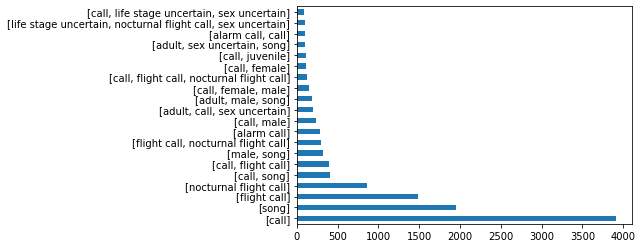

In [73]:
print(train_df['type'].value_counts()[:10])
train_df['type'].value_counts()[:20].plot(kind='barh')

In [ ]:

type_list = []
for i in train_df['type'].values:
    type_list += i

In [63]:
type_list_clean = []
for i in type_list:
    if i not in type_list_clean:
        type_list_clean.append(i)
        
print(type_list_clean)

['call', 'flight call', 'song', 'alarm call', 'traffic', 'adult', 'sex uncertain', 'male', 'begging call', 'mechanical tapping', 'begging call (?)', 'female', 'wing beats', 'Whi-Whee-Whew', 'female call', 'male call', 'rain', 'wing flutters', 'wing sounds', 'subsong', 'social calls', 'calls by attacking male', 'Alarmcalls', 'display', 'Call', 'courtship call', 'juvenile', 'various calls', 'chasing another tern', '"ki-ru" call', 'attack', 'nocturnal flight call', 'juvenile type rattle', 'Small group flying over.  Not recorded here during day', 'life stage uncertain', 'no', 'long call', 'advertisement call', 'kip call', 'uncertain', 'calls', 'alarm and flight calls', 'chicks and adult in breeding colony', 'nocturnal flightcall', 'Nocturnal Flight Call', 'Alarm call', 'Nocturnal flight call', 'NFC', 'nocturnal', 'night flight call', 'wings beats', 'human voices', 'hatchling or nestling', 'duet', 'drumming', 'Insect sounds in background', 'call,flight call,alarm call,aggressive call', 'Fli

## lets concat the features from train metadata to the 10sec  prediction table

## add a column with the file name

In [103]:
train_df['song_name'] = train_df['filename'].apply(lambda x: x.split('.')[0])

In [82]:
train_df.head()

,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,time,url,filename,song_name
0,afrsil1,[],"['call', 'flight call']",12.3910,-1.4930,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,2.5,08:00,https://www.xeno-canto.org/125458,afrsil1/XC125458.ogg,afrsil1/XC125458
1,afrsil1,"['houspa', 'redava', 'zebdov']",['call'],19.8801,-155.7254,Euodice cantans,African Silverbill,Dan Lane,Creative Commons Attribution-NonCommercial-Sha...,3.5,08:30,https://www.xeno-canto.org/175522,afrsil1/XC175522.ogg,afrsil1/XC175522
2,afrsil1,[],"['call', 'song']",16.2901,-16.0321,Euodice cantans,African Silverbill,Bram Piot,Creative Commons Attribution-NonCommercial-Sha...,4.0,11:30,https://www.xeno-canto.org/177993,afrsil1/XC177993.ogg,afrsil1/XC177993
3,afrsil1,[],"['alarm call', 'call']",17.0922,54.2958,Euodice cantans,African Silverbill,Oscar Campbell,Creative Commons Attribution-NonCommercial-Sha...,4.0,11:00,https://www.xeno-canto.org/205893,afrsil1/XC205893.ogg,afrsil1/XC205893
4,afrsil1,[],['flight call'],21.4581,-157.7252,Euodice cantans,African Silverbill,Ross Gallardy,Creative Commons Attribution-NonCommercial-Sha...,3.0,16:30,https://www.xeno-canto.org/207431,afrsil1/XC207431.ogg,afrsil1/XC207431


In [104]:
print(train_df.shape, train_df['song_name'].nunique())

(14852, 16) 14852


In [105]:
#  we are extracting using precomputed lenght 38
binary_df['song_name'] = binary_df['itemid'].apply(lambda x: x[38:].split('_')[0])

In [106]:
binary_df.head()

,itemid,hasbird,prediction,song_name
0,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.941831,moudov/XC138056
1,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.924060,moudov/XC316787
2,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.927552,moudov/XC391151
3,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.865301,moudov/XC268202
4,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.942084,moudov/XC621374


In [107]:
merged_binary_df = binary_df.merge(train_df, on='song_name')
print(binary_df.shape, merged_binary_df.shape)
merged_binary_df.to_csv('../prediction/binary_v3_SED/train_competition_v1_binary_merged.csv',index = False)

(71511, 4) (71511, 19)


In [108]:
merged_binary_df.head()

,itemid,hasbird,prediction,song_name,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,time,url,filename,primary_label_index,secondary_label_index
0,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.941831,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[]
1,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.857844,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[]
2,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.905810,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[]
3,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.823133,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[]
4,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.812675,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[]


In [109]:
from sklearn.model_selection import StratifiedKFold

SEED = 1
FOLDS = 8

skf = StratifiedKFold(n_splits=FOLDS, shuffle=True, random_state=SEED)

merged_binary_df['fold'] = -1
for fold,(idxT,idxV) in enumerate( skf.split(merged_binary_df,merged_binary_df['primary_label_index'].values)):
    merged_binary_df['fold'][idxV] = fold

In [111]:
merged_binary_df[merged_binary_df['fold']==0]['primary_label_index'].value_counts()

9      661
4      494
2      420
20     382
1      359
      ... 
124      2
144      1
137      1
140      1
149      1
Name: primary_label_index, Length: 148, dtype: int64

In [112]:
merged_binary_df[merged_binary_df['fold']==1]['primary_label_index'].value_counts()

9      661
4      494
2      420
20     382
1      359
      ... 
147      1
137      1
150      1
144      1
149      1
Name: primary_label_index, Length: 151, dtype: int64

In [113]:
merged_binary_df.to_csv('../prediction/binary_v3_SED/train_competition_v1_binary_merged.csv',index = False)

In [110]:
merged_binary_df.head()

,itemid,hasbird,prediction,song_name,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,time,url,filename,primary_label_index,secondary_label_index,fold
0,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.941831,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[],3
1,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.857844,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[],0
2,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.905810,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[],7
3,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.823133,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[],4
4,../data/librosa/competition/v1/10_sec/moudov/X...,0,0.812675,moudov/XC138056,moudov,[],['nest-coo pair at potential nest-site'],40.1226,-75.0635,Zenaida macroura,Mourning Dove,Paul Driver,Creative Commons Attribution-NonCommercial-Sha...,4.0,09:00,https://www.xeno-canto.org/138056,moudov/XC138056.ogg,33,[],0


In [ ]:
## just few more analysis about the less frequent class